In [20]:
import pandas as pd
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import joblib

In [21]:
# Load dataset
df = pd.read_csv("dataset.csv")

In [22]:
# Checking if necessary columns exist
required_columns = {'danceability', 'energy', 'speechiness', 'acousticness', 'valence', 'tempo', 'liveness', 'loudness', 'track_name', 'artists'}
if not required_columns.issubset(df.columns):
    raise KeyError(f"Dataset is missing required columns: {required_columns - set(df.columns)}")


In [27]:
# Selecting relevant features
features = ['danceability', 'energy', 'speechiness', 'acousticness', 'valence', 'tempo', 'liveness', 'loudness']
X = df[features]

In [28]:
# Creating mood labels based on valence and energy
def classify_mood(valence, energy):
    if valence >= 0.5 and energy >= 0.5:
        return "Happy"
    elif valence >= 0.5 and energy < 0.5:
        return "Calm"
    elif valence < 0.5 and energy >= 0.5:
        return "Energetic"
    else:
        return "Sad"

In [29]:
# Apply classification
df['mood'] = df.apply(lambda row: classify_mood(row['valence'], row['energy']), axis=1)

# Encode mood labels
y = df['mood'].astype('category').cat.codes

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [30]:
# Standardizing features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train model
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train_scaled, y_train)

RandomForestClassifier(random_state=42)

In [31]:
# Predictions
y_pred = model.predict(X_test_scaled)

In [32]:
# Evaluation
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

Accuracy: 1.0
Confusion Matrix:
 [[1812    0    0    0]
 [   0 7861    0    0]
 [   0    0 8657    0]
 [   0    0    0 4470]]
Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      1812
           1       1.00      1.00      1.00      7861
           2       1.00      1.00      1.00      8657
           3       1.00      1.00      1.00      4470

    accuracy                           1.00     22800
   macro avg       1.00      1.00      1.00     22800
weighted avg       1.00      1.00      1.00     22800



In [33]:
# Save model and scaler
joblib.dump(model, "mood_classifier.pkl")
joblib.dump(scaler, "scaler.pkl")

['scaler.pkl']

C:\Users\saima\AppData\Local\Temp\ipykernel_5200\1515460825.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=df['mood'], palette='viridis')


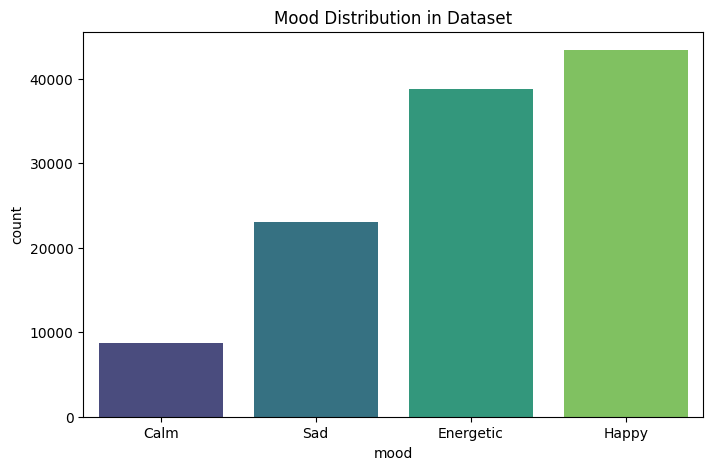

In [34]:
# Mood Distribution Visualization
plt.figure(figsize=(8,5))
sns.countplot(x=df['mood'], palette='viridis')
plt.title("Mood Distribution in Dataset")
plt.show()

In [35]:
# User Input for Mood-Based Playlist
selected_mood = input("Enter your mood (Happy, Sad, Energetic, Calm): ").capitalize()
if selected_mood in df['mood'].unique():
    if 'track_name' in df.columns and 'artists' in df.columns:
        playlist = df[df['mood'] == selected_mood][['track_name', 'artists']]
        print(f"\nSongs for {selected_mood} mood:")
        print(playlist.to_string(index=False))
    else:
        print("Error: Dataset does not contain 'track_name' and 'artists' columns.")
else:
    print("Invalid mood selection. Please choose from Happy, Sad, Energetic, or Calm.")



Songs for Happy mood:
                                                                                                                                                          track_name                                                                                                                                                                                                                                                                                                                                                          artists
                                                                                                                                                            Unlonely                                                                                                                                                                                                                                                                                                       